# Recent Extent of Water with Shapefile<img align="right" src="../Supplementary_data/DE_Africa_Logo_Stacked_RGB_small.jpg">

* **Products used:** 
[ga_ls8c_wofs_2](https://explorer.digitalearth.africa/ga_ls8c_wofs_2), 
[s2_l2a](https://explorer.digitalearth.africa/products/s2_l2a)



## Background
The United Nations have prescribed 17 "Sustainable Development Goals" (SDGs). This notebook attempts to monitor SDG Indicator 6.6.1 - change in the extent of water-related ecosystems. Indicator 6.6.1 has 4 sub-indicators:
>    i. The spatial extent of water-related ecosystems <br>
>    ii. The quantity of water contained within these ecosystems <br>
>    iii. The quality of water within these ecosystems <br>
>    iv. The health or state of these ecosystems <br>

This notebook primarily focuses on the first sub-indicator - spatial extents.

Modified Normalised Difference Water Index (MNDWI) from  Xu 1996 and [Water Observations from Space (WOfS)](https://www.ga.gov.au/scientific-topics/community-safety/flood/wofs/about-wofs) will be used to determine the spatial extent of water.


## Description
The notebook demonstrates how to:

1. Load data for a given location and time period
2. Set up a Dask cluster
3. Generate a time series
4. Generate the Map for Two time period
5. Create animation for the Product
6. Compare Two Time Periods

***

## Getting started
To run this analysis, run all the cells in the notebook, starting with the "Load packages" cell. 

### Load packages
Import Python packages that are used for the analysis.

In [29]:
%matplotlib inline

import datacube
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import sys, warnings
import xarray as xr
import geopandas as gpd

from IPython.display import Image
from matplotlib.colors import ListedColormap
from matplotlib.patches import Patch
from odc.ui import image_aspect
from odc.algo import xr_geomedian
from datacube.utils import geometry

sys.path.append('../../Scripts')
from deafrica_datahandling import load_ard, wofs_fuser
from deafrica_bandindices import calculate_indices
from deafrica_plotting import display_map, rgb, xr_animation
from deafrica_dask import create_local_dask_cluster
from deafrica_plotting import rgb, map_shapefile
from deafrica_spatialtools import xr_rasterize

from datacube.utils.aws import configure_s3_access
configure_s3_access(aws_unsigned=True, cloud_defaults=True)

While the summary plot is useful at a glance it can be interesting to see the full spatial picture at times .
The code below defines two useful functions: `closest_date` will find the date in a list of dates closest to any given date; 
`date_index` will return the position of a particular date in a list of dates. 
These functions are useful for selecting images to compare. 

In [32]:
def closest_date(list_of_dates, desired_date):
    return min(list_of_dates,
               key=lambda x: abs(x - np.datetime64(desired_date)))

### Connect to the datacube

Activate the datacube database, which provides functionality for loading and displaying stored Earth observation data.

In [33]:
dc = datacube.Datacube(app='water_extent_shape')

## Set up a Dask cluster

Dask can be used to better manage memory use and conduct the analysis in parallel. 
For an introduction to using Dask with Digital Earth Africa, see the [Dask notebook](../Beginners_guide/06_Parallel_processing_with_dask.ipynb).

>**Note**: We recommend opening the Dask processing window to view the different computations that are being executed; to do this, see the *Dask dashboard in DE Africa* section of the [Dask notebook](../Beginners_guide/06_Parallel_processing_with_dask.ipynb).

To activate Dask, set up the local computing cluster using the cell below.

In [34]:
create_local_dask_cluster()

/env/lib/python3.6/site-packages/distributed/node.py:155: UserWarning: Port 8787 is already in use.
Perhaps you already have a cluster running?
Hosting the HTTP server on port 45691 instead
  http_address["port"], self.http_server.port


Client Scheduler: tcp://127.0.0.1:39871 Dashboard: /user/brian.terry/proxy/45691/status,Cluster Workers: 1 Cores: 2 Memory: 13.11 GB


### Analysis parameters

The following cell sets the parameters, which define the area of interest and the length of time to conduct the analysis over.

The parameters are:

* `vector_file`: A shape file that defines the area to analyze.

* `Start_year and end_year`: The date range to analyse (e.g. `('2015', '2019')`.

* `Threshold_value`: This value sets the minimum amount of good data a scene must have before it will be loaded into memory e.g. `0.75` means only images with 75% good data will be retained.

**If running the notebook for the first time**, keep the default settings below.
This will demonstrate how the analysis works and provide meaningful results.
The default area is the Ruko Conservancy. 


<p style="color:red";><b>CHANGE FILE BELOW FOR DIFFERENT AREA

In [35]:
vector_file = 'data/Ruko_conservancy.geojson'

In [36]:
#read shapefile
gdf = gpd.read_file(vector_file)

#print gdf
gdf.head()

,AreakmSq,OBJECTID,NRT_Region,County,YearEstabl,LocationSo,ImageSourc,ImageDate,CollectedB,EditedBy,EditDate,Notes,AreaHa,ConsrvName,AreaKM2,id,geometry
0,178.96868,0,None,Baringo,None,None,None,1899-12-30,None,None,1899-12-30,None,17896.8679887869,Ruko,178.968679887869,0,"POLYGON ((180489.405 63848.881, 180448.606 638..."


In [37]:
#gdf.set_crs(crs='EPSG:32637',inplace=True, allow_override=True )
gdf.crs.to_epsg()

32637

## View the Area of Interest on an Interative map
The next cell will display the selected area on an interactive map.
Zoom in and out to get a better understanding of the area of interest.

In [38]:
map_shapefile(gdf, attribute='id')

Label(value='')

Map(center=[0.648084104061088, 36.12258148195494], controls=(ZoomControl(options=['position', 'zoom_in_text', …

In [39]:
time_range = ('2018', '2021')

bands = ['green',
         'swir_1']

resolution = (-10,10)

chunk_size = {'time':1,'x':1300,'y':1200} #tweaked for the size of the conservancy

water_query = {'time': time_range,
               'products': ['s2_l2a'],
               'measurements': bands,
               'resolution': resolution,
               'output_crs': 'EPSG:6933',
               'dask_chunks': chunk_size,
               'min_gooddata': .3
              }

In [40]:
geom = geometry.Geometry(gdf.iloc[0].geometry.__geo_interface__,
                         geometry.CRS(f'EPSG:{gdf.crs.to_epsg()}'))
    
water_ds = load_ard(dc=dc,
                    geopolygon= geom,
                    group_by='solar_day',
                    **water_query
                   )

water_mask = xr_rasterize(gdf,water_ds)

water_masked = water_ds.where(water_mask)

../../Scripts/deafrica_datahandling.py:240: UserWarning: Setting 'min_gooddata' percentage to > 0.0 will cause dask arrays to compute when loading pixel-quality data to calculate 'good pixel' percentage. This can slow the return of your dataset.
  warnings.warn("Setting 'min_gooddata' percentage to > 0.0 "


Using pixel quality parameters for Sentinel 2
Finding datasets
    s2_l2a
Counting good quality pixels for each time step
Filtering to 187 out of 225 time steps with at least 30.0% good quality pixels
Applying pixel quality/cloud mask
Returning 187 time steps as a dask array
Rasterizing to match xarray.DataArray dimensions (2387, 1212)


In [41]:
MNDWI_ds = calculate_indices(ds=water_masked, index='MNDWI', collection='s2')
MNDWI_median = MNDWI_ds.resample(time= 'M',label='right').median()

This function samples 10 captures across the entire dataset

In [42]:
def sample_xr(xarray,var=None):        
    xarray[var].isel(time = range(0,xarray.dims['time'], -(xarray.dims['time']//-10))).plot(col='time', col_wrap=5,cmap='viridis')

## Load and view data

## Calculate the area per pixel
The number of pixels can be used for the area of the waterbody if the pixel area is known. 
Run the following cell to generate the necessary constants for performing this conversion.

In [43]:
pixel_length = water_query["resolution"][1]  # in metres
m_per_km = 1000  # conversion from metres to kilometres
area_per_pixel = pixel_length**2 / m_per_km**2

## Calculating the extent of water
Calculates the area pixels classified as water

In [44]:
water = MNDWI_median.where(MNDWI_median.MNDWI>0,np.nan)

In [45]:
area_ds = water.where(np.isnan(water.MNDWI),1)

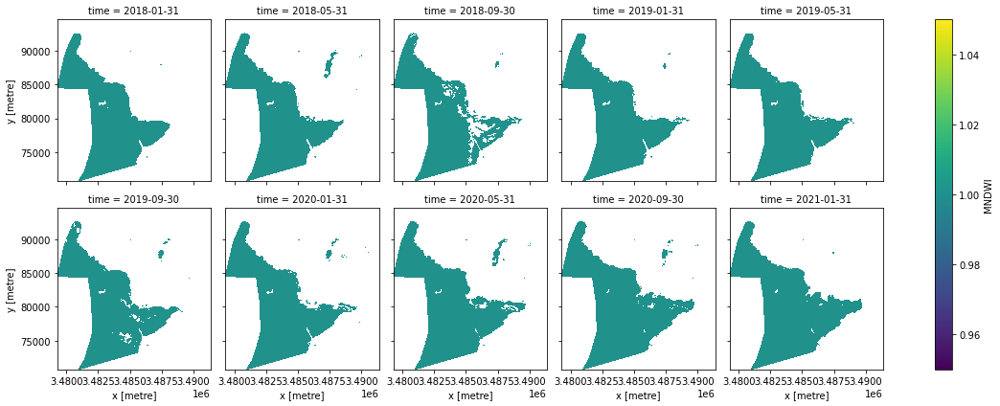

In [46]:
sample_xr(area_ds,'MNDWI')

In [47]:
# Calculate area of water pixels
ds_valid_water_area = area_ds.MNDWI.sum(dim=['x', 'y']) * area_per_pixel

In [48]:
ds_valid_water_area = ds_valid_water_area.compute()

### Plot Monthly Time Series from the `Start year` to `End year`

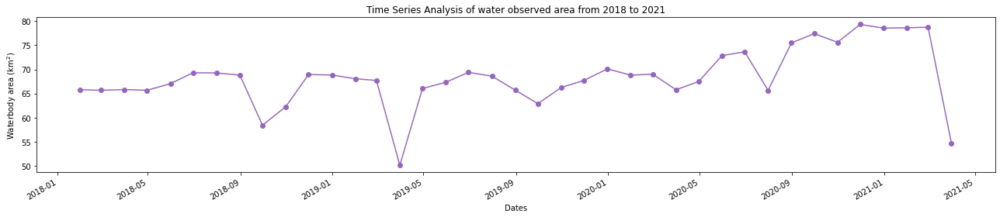

In [49]:
plt.figure(figsize=(18, 4))
ds_valid_water_area.plot(marker='o', color='#9467bd')
plt.title(f'Time Series Analysis of water observed area from {time_range[0]} to {time_range[1]}')
plt.xlabel('Dates')
plt.ylabel('Waterbody area (km$^2$)')
plt.tight_layout()

## Determine minimum and maximum water extent
The next cell extract the Minimum and Maximum extent of water from the dataset using the `min` and `max` functions, we then add the dates to an `xarray.DataArray`.

In [50]:
min_water_area_date, max_water_area_date =  min(ds_valid_water_area), max(ds_valid_water_area)
time_xr = xr.DataArray([min_water_area_date.time.values, max_water_area_date.time.values], dims=["time"])

In [51]:
time_xr

<xarray.DataArray (time: 2)>
array(['2019-03-31T00:00:00.000000000', '2020-11-30T00:00:00.000000000'],
      dtype='datetime64[ns]')
Dimensions without coordinates: time

## Plotting
Plot water classified pixel for the two dates where we have the minimum and maximum surface water extent.

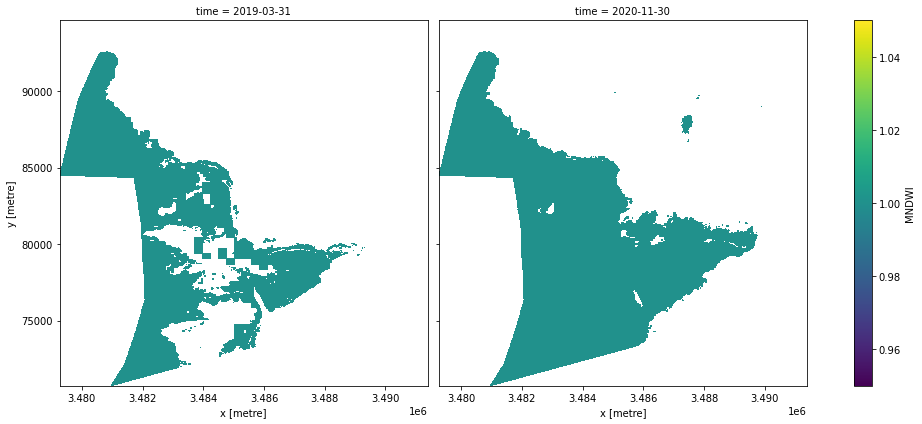

In [60]:
area_ds.MNDWI.sel(time=time_xr).plot(col="time", col_wrap=2, robust=True, figsize=(14, 6), cmap='viridis')

In [61]:
rgb_query = {'time': time_range,
               'products': ['s2_l2a'],
               'measurements': ['red', 'green', 'blue'],
               'resolution': resolution,
               'output_crs': 'EPSG:6933',
               'dask_chunks': chunk_size,
               'min_gooddata': .3
              }
#load Visible data
ds_rgb = load_ard(dc=dc,
                  geopolygon= geom,
                  group_by='solar_day',
                  **rgb_query
                 )
mask = xr_rasterize(gdf,ds_rgb)

rgb_masked = ds_rgb.where(mask)
print(ds_rgb) 

../../Scripts/deafrica_datahandling.py:240: UserWarning: Setting 'min_gooddata' percentage to > 0.0 will cause dask arrays to compute when loading pixel-quality data to calculate 'good pixel' percentage. This can slow the return of your dataset.
  warnings.warn("Setting 'min_gooddata' percentage to > 0.0 "


Using pixel quality parameters for Sentinel 2
Finding datasets
    s2_l2a
Counting good quality pixels for each time step
Filtering to 187 out of 225 time steps with at least 30.0% good quality pixels
Applying pixel quality/cloud mask
Returning 187 time steps as a dask array
Rasterizing to match xarray.DataArray dimensions (2387, 1212)
<xarray.Dataset>
Dimensions:      (time: 187, x: 1212, y: 2387)
Coordinates:
  * time         (time) datetime64[ns] 2018-01-02T08:07:58 ... 2021-03-12T08:...
  * y            (y) float64 9.460e+04 9.46e+04 ... 7.076e+04 7.074e+04
  * x            (x) float64 3.479e+06 3.479e+06 ... 3.491e+06 3.491e+06
    spatial_ref  int32 6933
Data variables:
    red          (time, y, x) float32 dask.array<chunksize=(1, 1200, 1212), meta=np.ndarray>
    green        (time, y, x) float32 dask.array<chunksize=(1, 1200, 1212), meta=np.ndarray>
    blue         (time, y, x) float32 dask.array<chunksize=(1, 1200, 1212), meta=np.ndarray>
Attributes:
    crs:           EPSG:

In [ ]:
geomedian = rgb_masked.resample(time= 'M',label='right').median().compute()

In [ ]:
times = geomedian.sel(time=time_xr)
rgb(times, col='time', size=10) 

## Animating time series
In the next cell, we plot the dataset we loaded above as an animation GIF, using the [`xr_animation`](../Frequently_used_code/Animated_timeseries.ipynb) function.
The `output_path` will be saved in the directory where the script is found and you can change the names to prevent files overwrite.

Exporting animation to rgb_water_extent.gif


  0%|          | 0/39 (0.0 seconds remaining at ? frames/s)

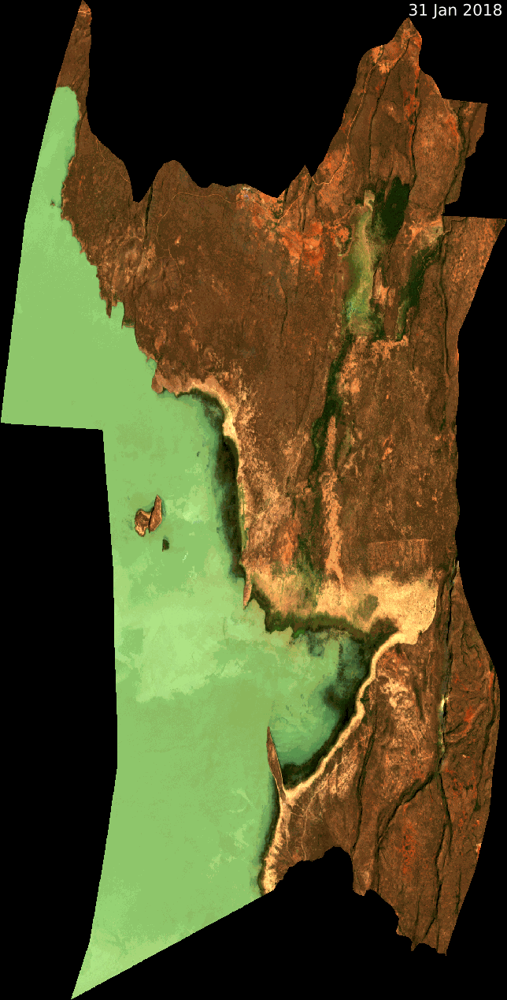

In [52]:
xr_animation(ds=geomedian, 
             output_path='rgb_water_extent.gif',
             bands = ['red', 'green', 'blue'],
             interval=500, 
             width_pixels=644,
             show_colorbar=False
            )

# Plot animated gif
plt.close()
Image(filename='rgb_water_extent.gif')

Exporting animation to water_extent.gif


  0%|          | 0/39 (0.0 seconds remaining at ? frames/s)

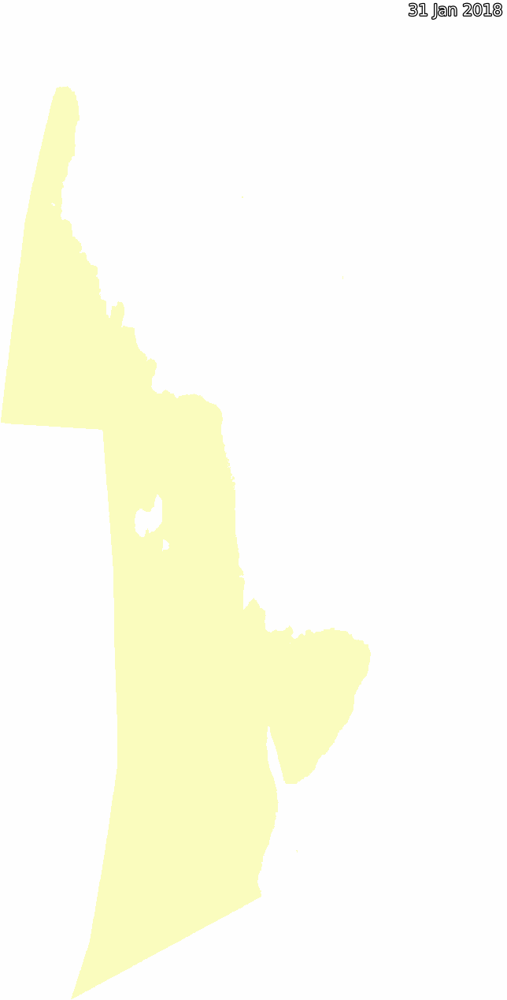

In [54]:
xr_animation(ds=area_ds, 
             output_path='water_extent.gif',
             bands = ['MNDWI'],
             interval=500, 
             width_pixels=644,
             show_colorbar=False
            )

# Plot animated gif
plt.close()
Image(filename='water_extent.gif')

## Compare Two Time Periods
The following cells determine the maximum extent of water for two different years. 
* `baseline_year` : The baseline year for the analysis
* `analysis_year` : The year to compare to the baseline year

* The maximum water extent for the two years are determine from the datatset `ds_valid_water_area`

In [27]:
baseline = '2020-02-01'
analysis = '2021-02-01'

baseline_ds, analysis_ds = ds_valid_water_area.sel(time= baseline, method ='nearest') , ds_valid_water_area.sel(time= analysis, method ='nearest')

In [28]:
time_xr = xr.DataArray([baseline_ds.time.values, analysis_ds.time.values], dims=["time"])

## Plotting
Plot water extent of the MNDWI product for the two years.

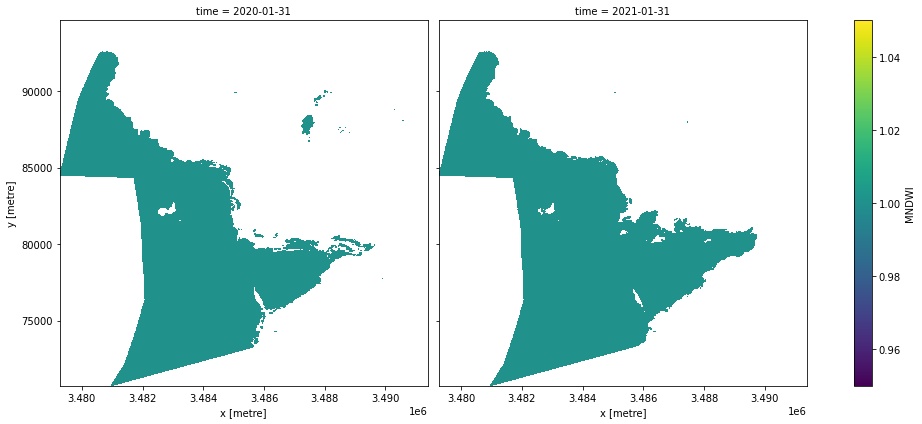

In [29]:
area_ds.MNDWI.sel(time=time_xr).plot(col="time", col_wrap=2, robust=True, figsize=(14, 6), cmap='viridis')

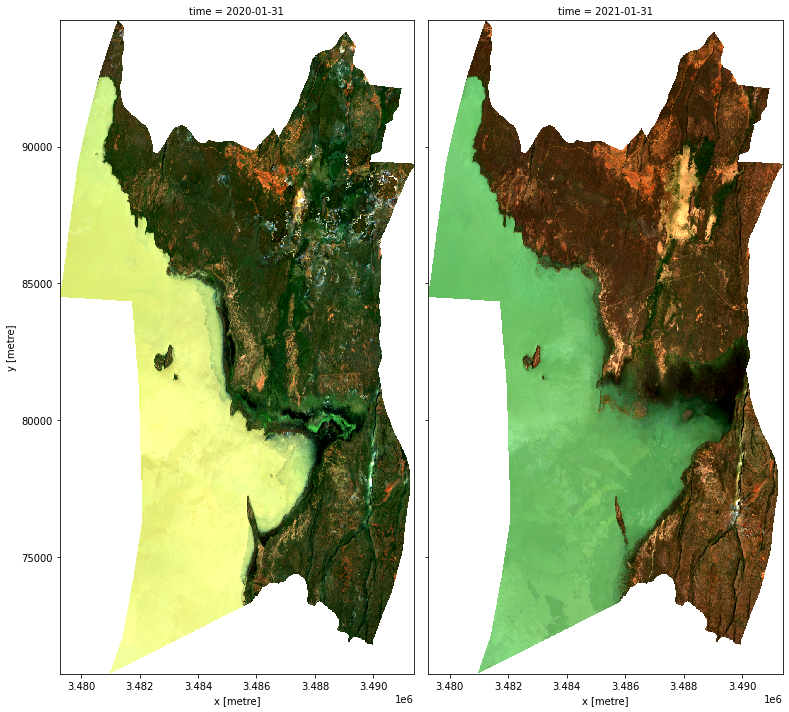

In [30]:
times = geomedian.sel(time=time_xr)
rgb(times, col='time', size=10) 

## Calculating the change for the two periods
The cells below calculate the amount of water gain, loss and stable for the two periods

In [31]:
# The two period Extract the two periods(Baseline and analysis) dataset from
ds_selected = area_ds.MNDWI.where(area_ds.MNDWI == 1, 0).sel(time=time_xr)

#The dataset array is transform to 1 and 0 using the `astype(int)` function.
analyse_total_value = ds_selected[1]
change = analyse_total_value - ds_selected[0]

#The various scenarios are extracted from the `change` variable for the tw years
#Water gain  is 1
water_appeared = change.where(change == 1)

#Permanent water = 0
permanent_water = change.where((change == 0) & (analyse_total_value == 1))

#Permanent Land = 0
permanent_land = change.where((change == 0) & (analyse_total_value == 0))

#Water loss = -1
water_disappeared = change.where(change == -1)

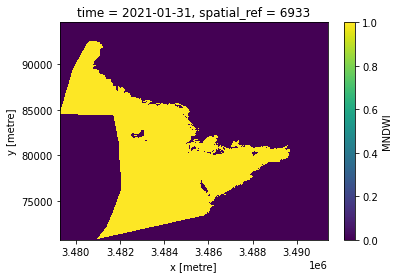

In [32]:
ds_selected[1].plot()

The cell below calculate the area of water extent for water_loss, water_gain, permanent water and land 

In [33]:
total_area = analyse_total_value.count().values * area_per_pixel
water_apperaed_area = water_appeared.count().values * area_per_pixel
permanent_water_area = permanent_water.count().values * area_per_pixel
permanent_land_area = permanent_land.count().values * area_per_pixel
water_disappeared_area = water_disappeared.count().values * area_per_pixel

The cell below calculate the percentage of area of water extent for water_loss, water_gain, permanent water and land 

In [34]:
# Percentage Change in water extent
percentage_water_gain = round((water_apperaed_area /  total_area) * 100 , 2)
percentage_water_loss = round(water_disappeared_area /  total_area * 100 , 2)
percentage_permanent_water = round(permanent_water_area /  total_area * 100 , 2)
percentage_permanent_land = round(permanent_land_area /  total_area * 100, 2)

## Plotting
The water variables are plotted to visualised the result

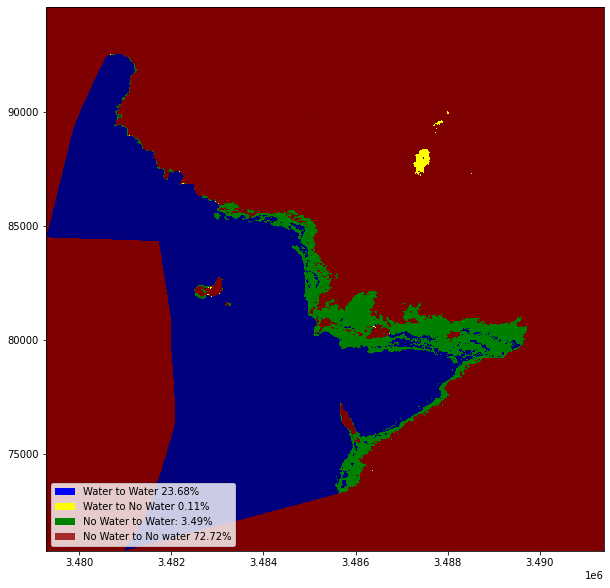

In [35]:
water_appeared_color = 'Green'
water_disappeared_color = 'Yellow'
stable_color = 'Blue'
land_color = 'Brown'

plot_aspect = image_aspect(area_ds.MNDWI)

ds_selected[1].plot.imshow(cmap='jet_r', add_colorbar=False, add_labels=False, figsize=(10,10))
water_appeared.plot.imshow(cmap=ListedColormap([water_appeared_color]), add_colorbar=False, add_labels=False)
water_disappeared.plot.imshow(cmap=ListedColormap([water_disappeared_color]), add_colorbar=False, add_labels=False)

plt.legend(
        [Patch(facecolor=stable_color), Patch(facecolor=water_disappeared_color), Patch(facecolor=water_appeared_color),   Patch(facecolor=land_color)], 
        [f'Water to Water {percentage_permanent_water}%', f'Water to No Water {percentage_water_loss}%' , f'No Water to Water: {percentage_water_gain}%',  
         f'No Water to No water {percentage_permanent_land}%'],
         loc = 'lower left'
    );

In [52]:
wofs_query = {
    'geopolygon':geom,
    'resolution': (-30, 30),
    'output_crs':'EPSG:6933',
    'time': time_range,
    'dask_chunks':{'time':1,'x':1000,'y':1000}
}


# Load WOfS
wofs_summary = dc.load(product=["ga_ls8c_wofs_2_summary"],
               group_by='solar_day',
               **wofs_query
              )

In [53]:
wofs_summary

<xarray.Dataset>
Dimensions:      (time: 1, x: 405, y: 796)
Coordinates:
  * time         (time) datetime64[ns] 2016-07-01T23:59:59.999500
  * y            (y) float64 9.460e+04 9.458e+04 ... 7.078e+04 7.076e+04
  * x            (x) float64 3.479e+06 3.479e+06 ... 3.491e+06 3.491e+06
    spatial_ref  int32 6933
Data variables:
    count_wet    (time, y, x) int16 dask.array<chunksize=(1, 796, 405), meta=np.ndarray>
    count_clear  (time, y, x) int16 dask.array<chunksize=(1, 796, 405), meta=np.ndarray>
    frequency    (time, y, x) float32 dask.array<chunksize=(1, 796, 405), meta=np.ndarray>
Attributes:
    crs:           EPSG:6933
    grid_mapping:  spatial_ref

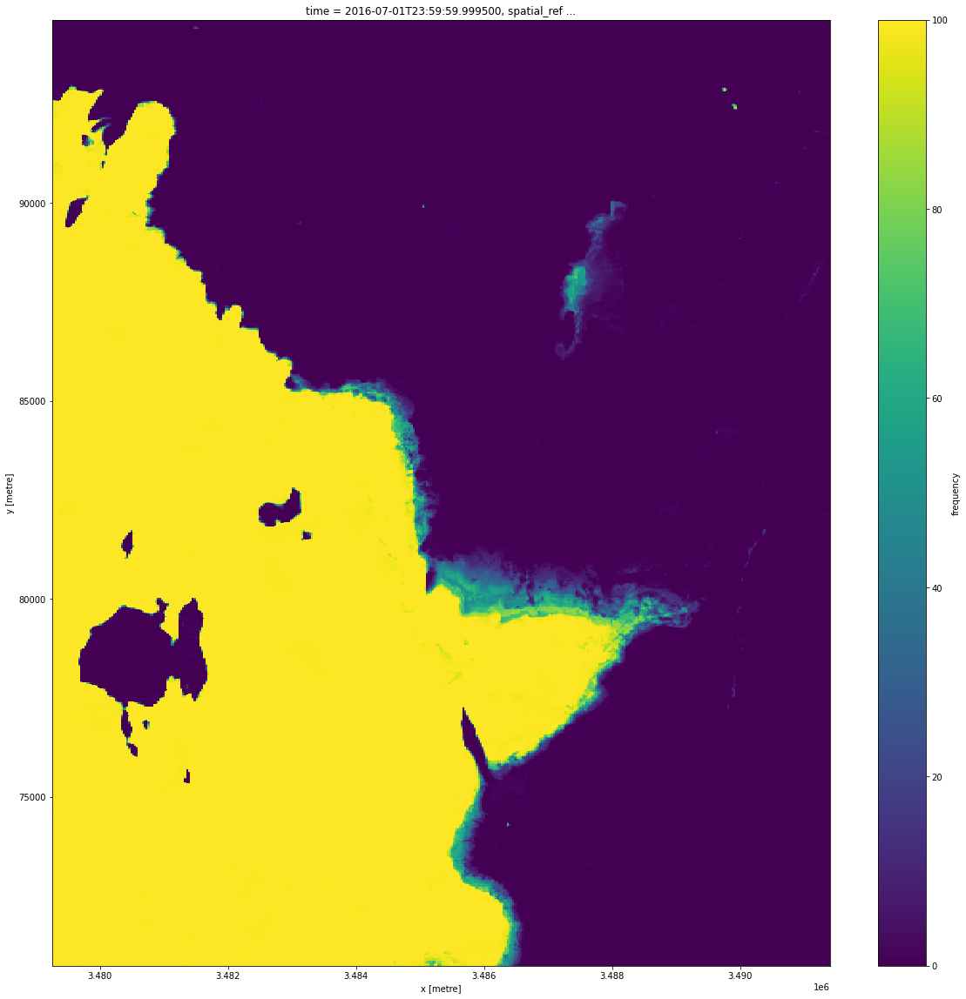

In [54]:
water_frequency = (wofs_summary.frequency*100)
plt.figure(figsize=(20,20))
water_frequency.isel(time= 0).plot()

In [55]:
query = {
    'geopolygon':geom,
    'resolution': (-30, 30),
    'output_crs':'EPSG:6933',
    'time': (1984, 2018),
    'dask_chunks':{'time':1,'x':1000,'y':1000}
}

wofs_complete = dc.load(product=["ls_usgs_wofs_summary"],
             group_by='solar_day',
             **query
            )

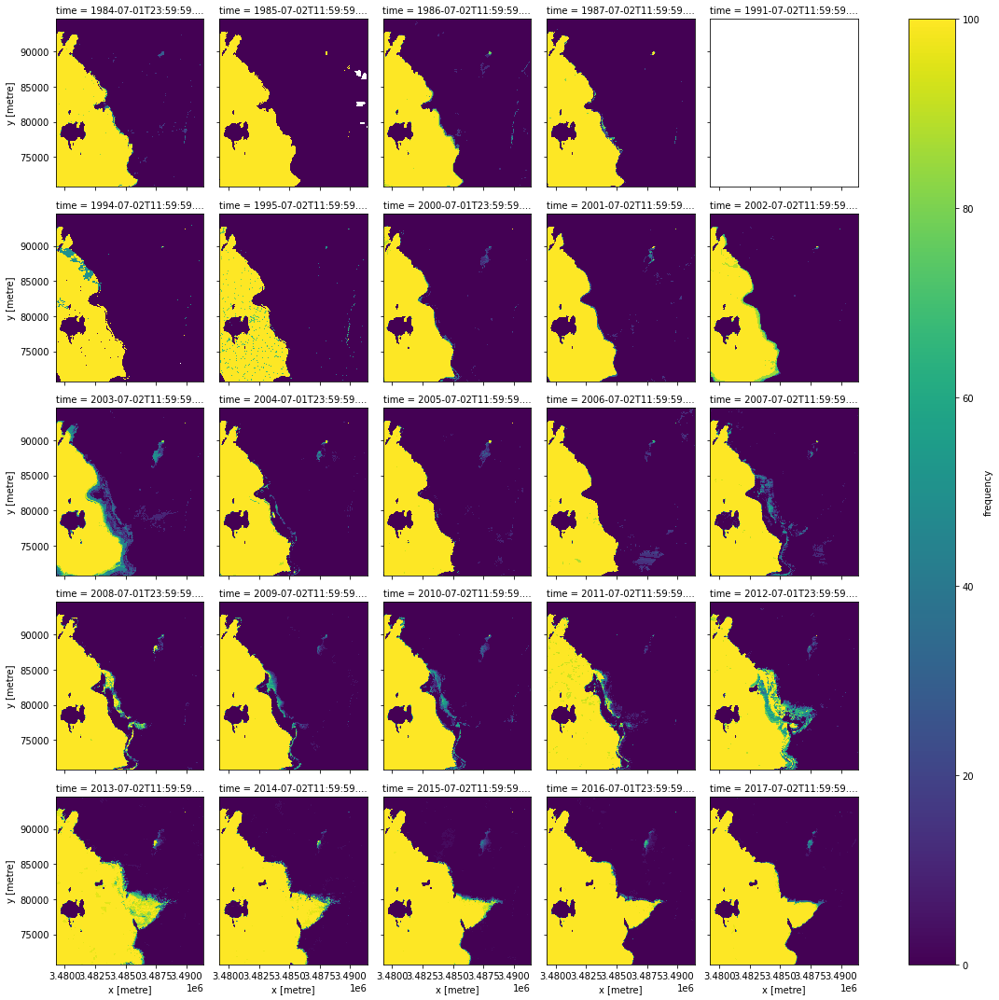

In [56]:
water_frequency_history = (wofs_complete.frequency*100)
water_frequency_history.plot(col='time', col_wrap=5)

In [57]:
water_frequency_history

<xarray.DataArray 'frequency' (time: 25, y: 796, x: 405)>
dask.array<mul, shape=(25, 796, 405), dtype=float32, chunksize=(1, 796, 405), chunktype=numpy.ndarray>
Coordinates:
  * time         (time) datetime64[ns] 1984-07-01T23:59:59.999500 ... 2017-07...
  * y            (y) float64 9.460e+04 9.458e+04 ... 7.078e+04 7.076e+04
  * x            (x) float64 3.479e+06 3.479e+06 ... 3.491e+06 3.491e+06
    spatial_ref  int32 6933

In [58]:
wofs_complete['frequency'] = wofs_complete.frequency * 100

In [59]:
xr_animation(ds=wofs_complete, 
             output_path='water_frgdfency.gif',
             bands = ['frequency'],
             interval=200, 
             width_pixels=1000,
             show_colorbar=True,
             percentile_stretch=(0, 1),
             #show_gdf=gdf,
             show_text='Historical Annual Water Frequency',
            )
plt.close()
Image(filename='water_frequency.gif')

Exporting animation to water_frgdfency.gif


  0%|          | 0/25 (0.0 seconds remaining at ? frames/s)

FileNotFoundError: [Errno 2] No such file or directory: 'water_frequency.gif'

***

## Additional information

**License:** The code in this notebook is licensed under the [Apache License, Version 2.0](https://www.apache.org/licenses/LICENSE-2.0). 
Digital Earth Africa data is licensed under the [Creative Commons by Attribution 4.0](https://creativecommons.org/licenses/by/4.0/) license.

**Contact:** If you need assistance, please post a question on the [Open Data Cube Slack channel](http://slack.opendatacube.org/) or on the [GIS Stack Exchange](https://gis.stackexchange.com/questions/ask?tags=open-data-cube) using the `open-data-cube` tag (you can view previously asked questions [here](https://gis.stackexchange.com/questions/tagged/open-data-cube)).
If you would like to report an issue with this notebook, you can file one on [Github](https://github.com/digitalearthafrica/deafrica-sandbox-notebooks).

**Last modified:** July 2020

**Compatible datacube version:** 

In [ ]:
print(datacube.__version__)

## Tags
Browse all available tags on the DE Africa User Guide's [Tags Index](https://) (placeholder as this does not exist yet)